In [1]:
import pandas as pd

weatherHourly = pd.read_csv('2010-2019/hourly_data_combined_2010_to_2019.csv')
dailyDatacombined = pd.read_csv('2010-2019/daily_data_combined_2010_to_2019.csv')


In [2]:
print(weatherHourly.columns)
print(dailyDatacombined.columns)

Index(['city_name', 'latitude', 'longitude', 'datetime', 'temperature_2m',
       'relative_humidity_2m', 'dew_point_2m', 'apparent_temperature',
       'precipitation', 'rain', 'snowfall', 'snow_depth', 'weather_code',
       'pressure_msl', 'surface_pressure', 'cloud_cover', 'cloud_cover_low',
       'cloud_cover_mid', 'cloud_cover_high', 'et0_fao_evapotranspiration',
       'vapour_pressure_deficit', 'wind_speed_10m', 'wind_speed_100m',
       'wind_direction_10m', 'wind_direction_100m', 'wind_gusts_10m',
       'soil_temperature_0_to_7cm', 'soil_temperature_7_to_28cm',
       'soil_temperature_28_to_100cm', 'soil_temperature_100_to_255cm',
       'soil_moisture_0_to_7cm', 'soil_moisture_7_to_28cm',
       'soil_moisture_28_to_100cm', 'soil_moisture_100_to_255cm',
       'shortwave_radiation', 'direct_radiation', 'diffuse_radiation',
       'direct_normal_irradiance', 'global_tilted_irradiance',
       'terrestrial_radiation', 'shortwave_radiation_instant',
       'direct_radiation_

       city_name      latitude     longitude             datetime  \
count   12007776  1.200778e+07  1.200778e+07             12007776   
unique       137           NaN           NaN                87648   
top     Alaminos           NaN           NaN  2019-12-31 07:00:00   
freq       87648           NaN           NaN                  137   
mean         NaN  1.193921e+01  1.227445e+02                  NaN   
std          NaN  3.178625e+00  1.828147e+00                  NaN   
min          NaN  6.087220e+00  1.187333e+02                  NaN   
25%          NaN  9.310280e+00  1.210254e+02                  NaN   
50%          NaN  1.160806e+01  1.228706e+02                  NaN   
75%          NaN  1.457010e+01  1.240272e+02                  NaN   
max          NaN  1.819889e+01  1.265733e+02                  NaN   

        temperature_2m  relative_humidity_2m  dew_point_2m  \
count     1.200778e+07          1.200778e+07  1.200778e+07   
unique             NaN                   NaN   

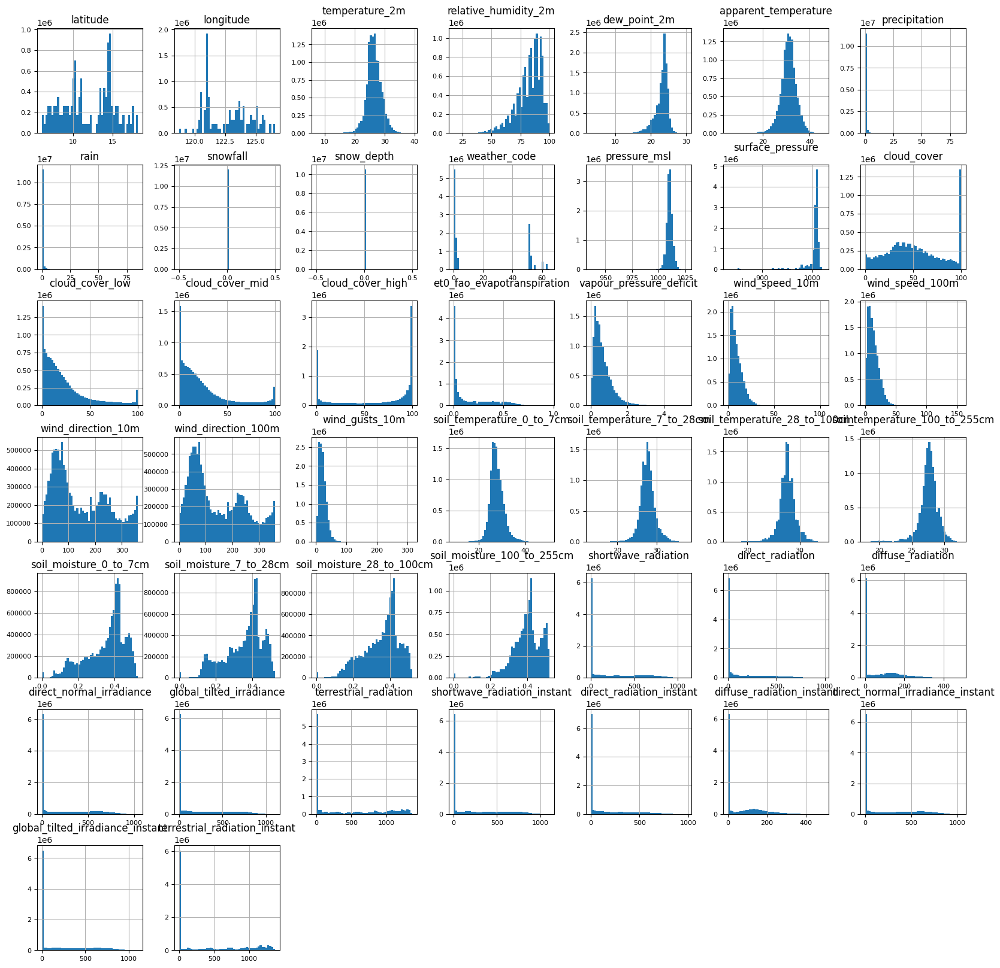

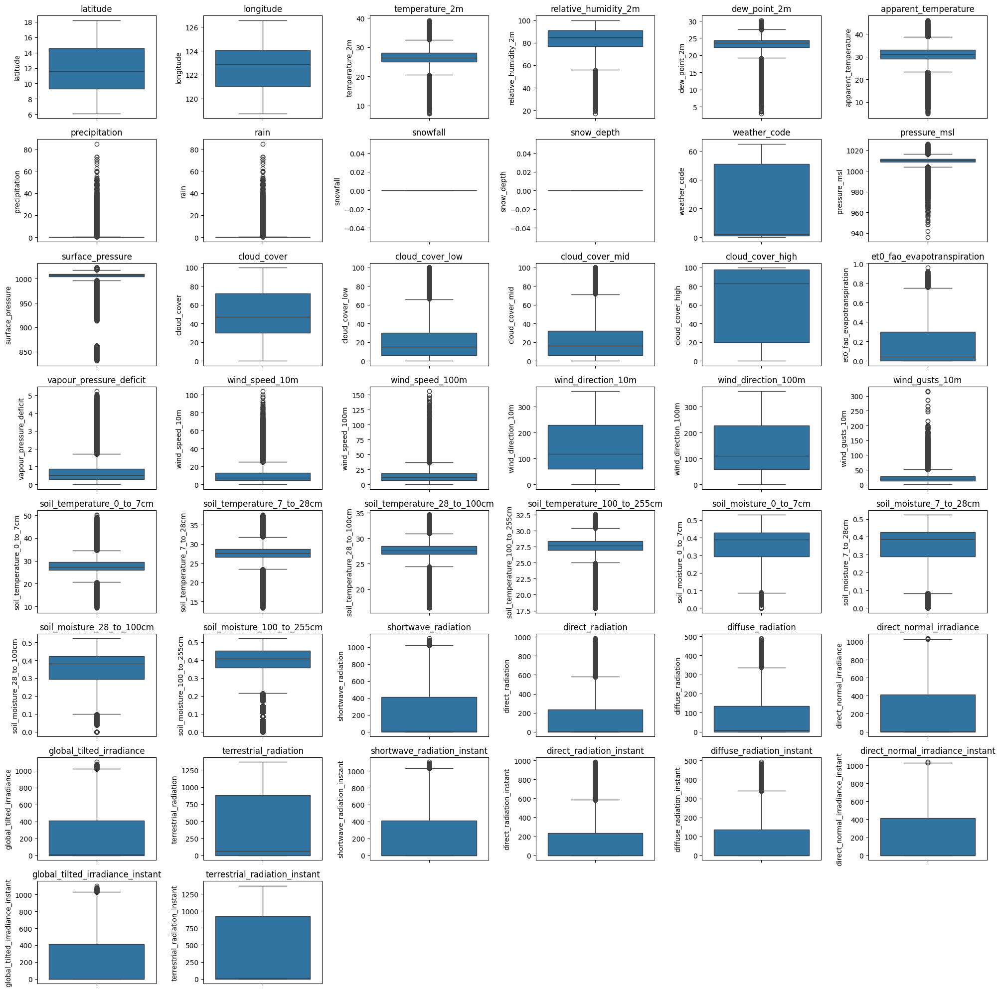

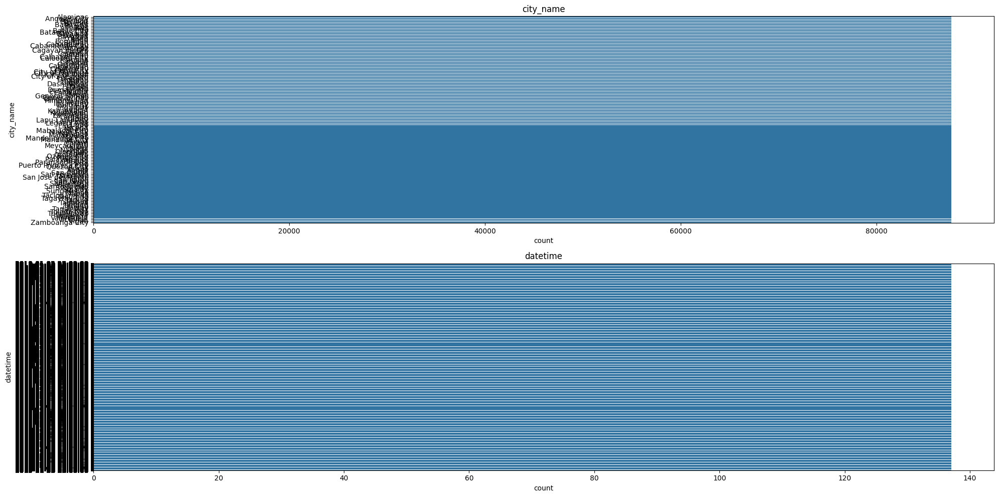

In [3]:
import seaborn as sns

import matplotlib.pyplot as plt

# Display basic statistics for each column
print(weatherHourly.describe(include='all'))

# Plot histograms for each numerical column
weatherHourly.hist(figsize=(20, 20), bins=50, xlabelsize=8, ylabelsize=8)
plt.show()

# Plot boxplots for each numerical column
plt.figure(figsize=(20, 20))
for i, column in enumerate(weatherHourly.select_dtypes(include=['float64', 'int64']).columns, 1):
    plt.subplot(8, 6, i)
    sns.boxplot(y=weatherHourly[column])
    plt.title(column)
plt.tight_layout()
plt.show()

# Plot count plots for each categorical column
plt.figure(figsize=(20, 10))
for i, column in enumerate(weatherHourly.select_dtypes(include=['object']).columns, 1):
    plt.subplot(2, 1, i)
    sns.countplot(y=weatherHourly[column])
    plt.title(column)
plt.tight_layout()
plt.show()

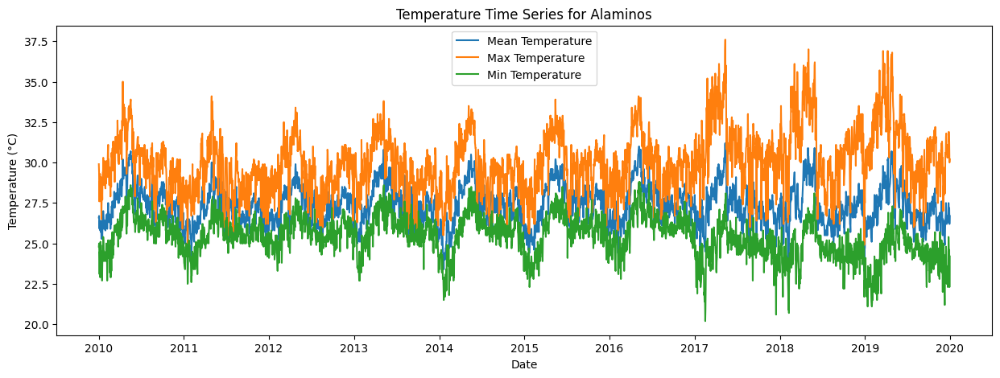

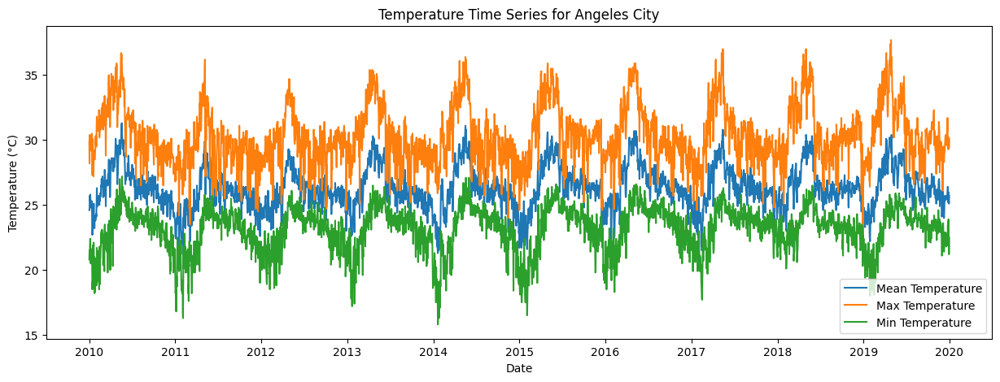

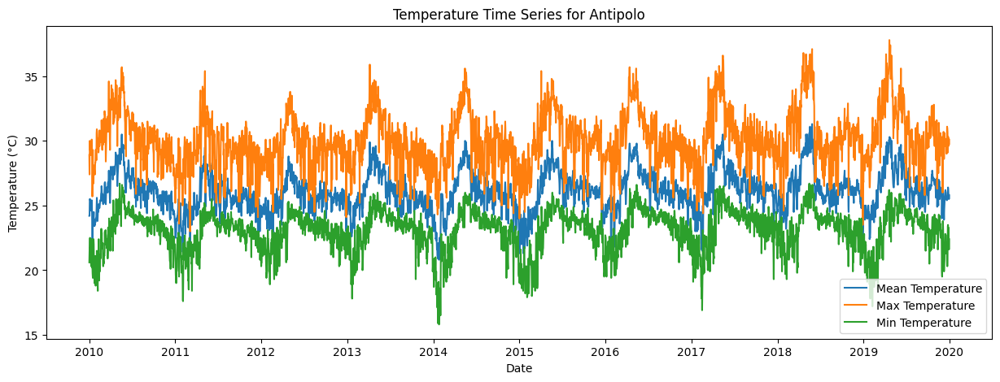

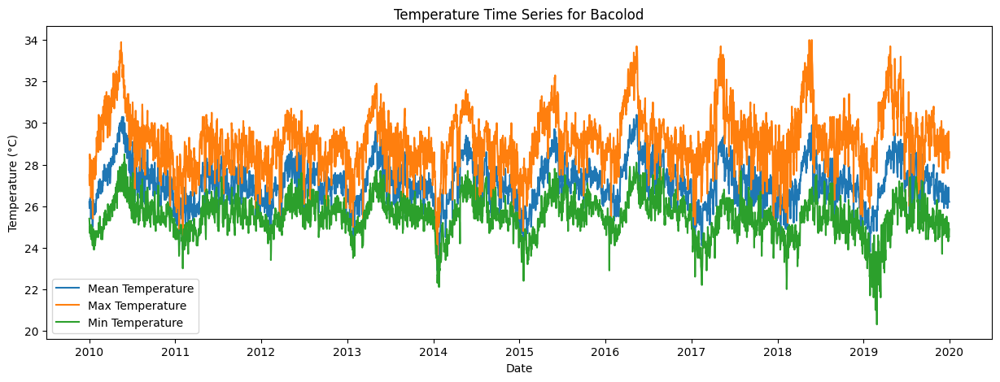

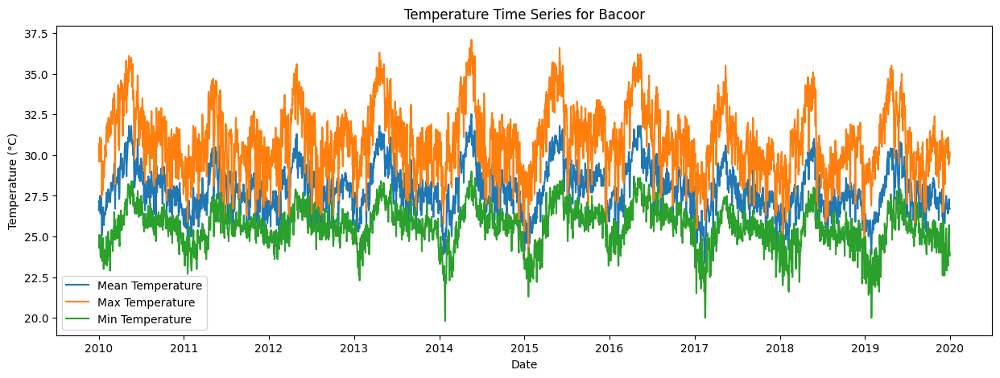

...

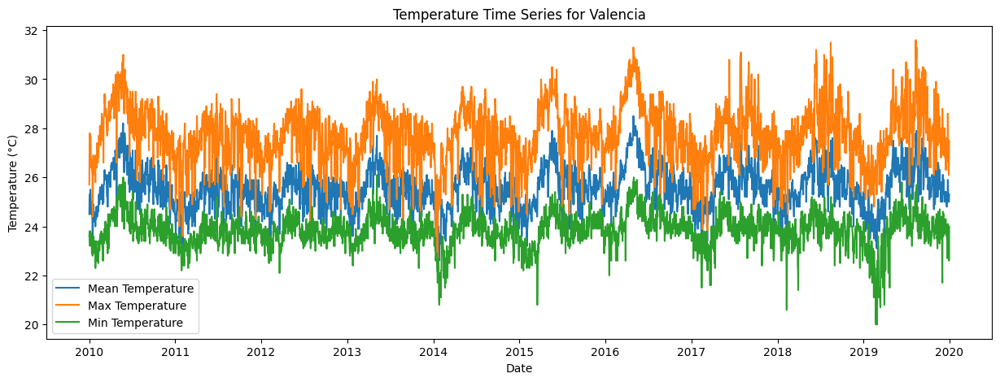

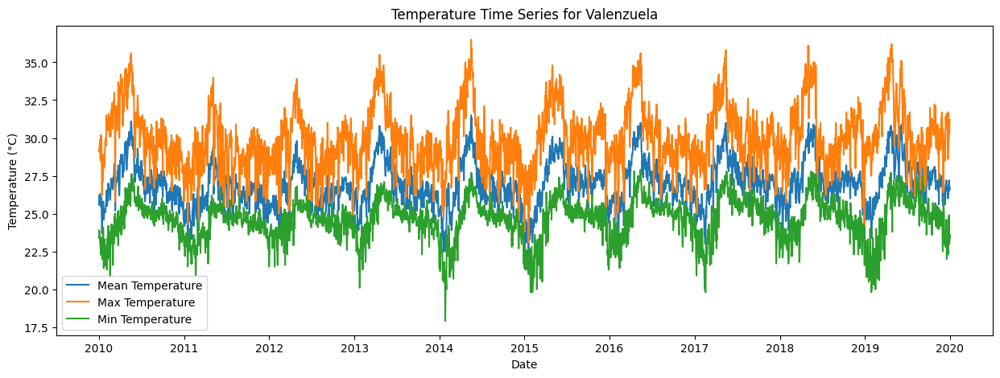

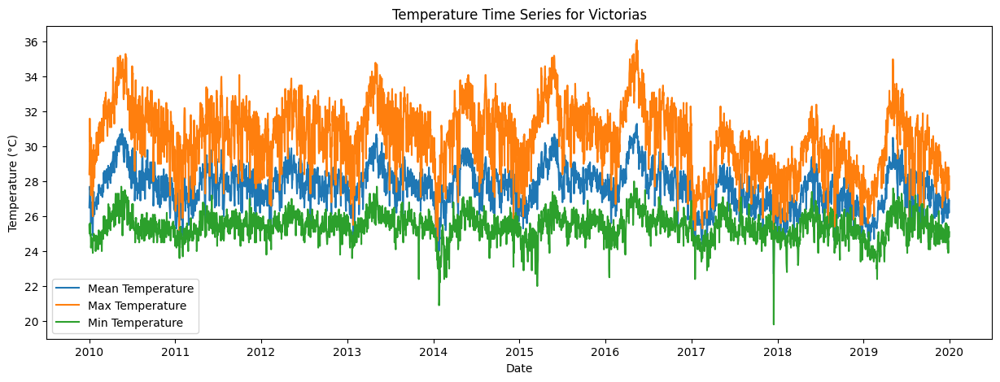

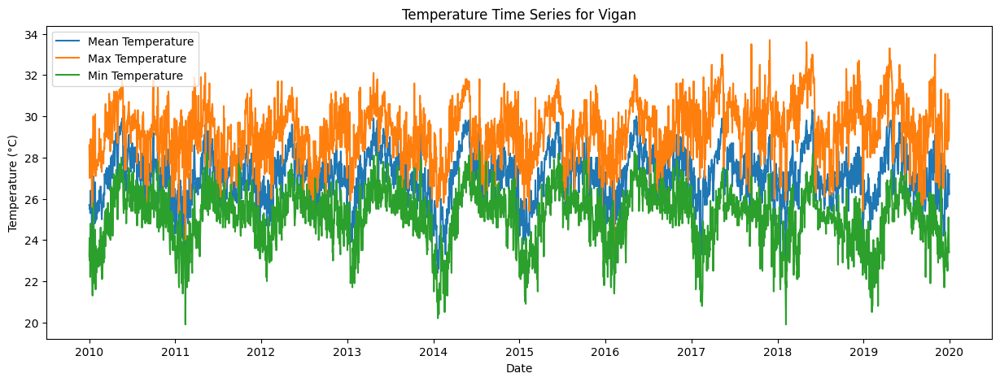

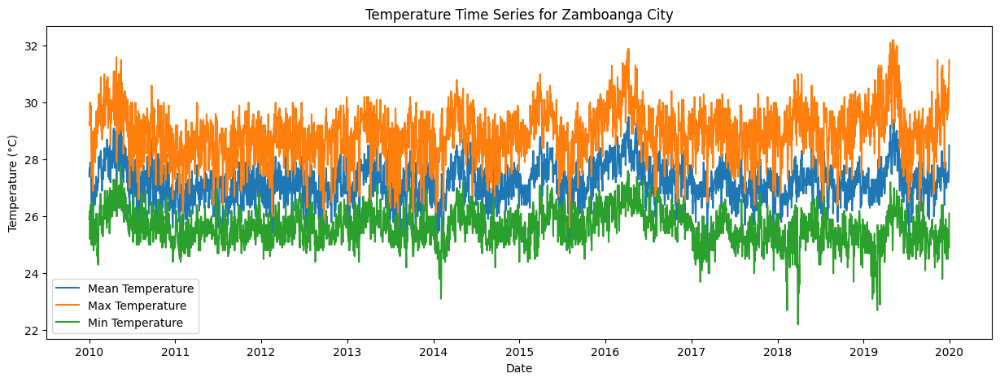

In [4]:
import matplotlib.pyplot as plt

# Convert the datetime column to datetime type
dailyDatacombined['datetime'] = pd.to_datetime(dailyDatacombined['datetime'])

# Get the list of unique cities
cities = dailyDatacombined['city_name'].unique()

# Plot time series for each city
for city in cities:
    city_data = dailyDatacombined[dailyDatacombined['city_name'] == city]
    plt.figure(figsize=(15, 5))
    plt.plot(city_data['datetime'], city_data['temperature_2m_mean'], label='Mean Temperature')
    plt.plot(city_data['datetime'], city_data['temperature_2m_max'], label='Max Temperature')
    plt.plot(city_data['datetime'], city_data['temperature_2m_min'], label='Min Temperature')
    plt.title(f'Temperature Time Series for {city}')
    plt.xlabel('Date')
    plt.ylabel('Temperature (°C)')
    plt.legend()
    plt.show()

In [5]:
from statsmodels.tsa.stattools import adfuller

# Function to perform ADF test
def adf_test(series):
    result = adfuller(series.dropna())
    return result[1]  # Return the p-value

# Apply ADF test to each numerical column
stationary_columns = []
non_stationary_columns = []

for column in city_data.select_dtypes(include=['float64', 'int64']).columns:
    if city_data[column].nunique() > 1:  # Check if the column is not constant
        p_value = adf_test(city_data[column])
        if p_value < 0.05:
            stationary_columns.append(column)
        else:
            non_stationary_columns.append(column)
    else:
        print(f"Skipping column {column} because it is constant.")

print("Stationary columns:", stationary_columns)
print("Non-stationary columns:", non_stationary_columns)

Skipping column latitude because it is constant.
Skipping column longitude because it is constant.
Skipping column snowfall_sum because it is constant.
Stationary columns: ['weather_code', 'temperature_2m_max', 'temperature_2m_min', 'temperature_2m_mean', 'apparent_temperature_max', 'apparent_temperature_min', 'apparent_temperature_mean', 'daylight_duration', 'sunshine_duration', 'precipitation_sum', 'rain_sum', 'precipitation_hours', 'wind_speed_10m_max', 'wind_gusts_10m_max', 'wind_direction_10m_dominant', 'shortwave_radiation_sum', 'et0_fao_evapotranspiration']
Non-stationary columns: []


In [6]:
from statsmodels.tsa.arima.model import ARIMA

# Function to apply ARIMA model
def apply_arima(series, order=(5, 1, 0)):
    model = ARIMA(series, order=order)
    model_fit = model.fit()
    return model_fit

# Apply ARIMA to temperature data for each city
arima_results = {}

for city in cities:
    city_data = dailyDatacombined[dailyDatacombined['city_name'] == city]
    city_data = city_data.set_index('datetime')
    temperature_series = city_data['temperature_2m_mean']
    
    if temperature_series.nunique() > 1:  # Check if the series is not constant
        arima_results[city] = apply_arima(temperature_series)
    else:
        print(f"Skipping city {city} because the temperature series is constant.")

# Print summary of ARIMA results for each city
for city, result in arima_results.items():
    print(f"ARIMA results for {city}:")
    print(result.summary())
    print("\n")

d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWar

ARIMA results for Alaminos:
                                SARIMAX Results                                
Dep. Variable:     temperature_2m_mean   No. Observations:                 3652
Model:                  ARIMA(5, 1, 0)   Log Likelihood               -2668.588
Date:                 Fri, 13 Dec 2024   AIC                           5349.176
Time:                         23:31:22   BIC                           5386.392
Sample:                     01-01-2010   HQIC                          5362.430
                          - 12-31-2019                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.1213      0.014     -8.495      0.000      -0.149      -0.093
ar.L2         -0.1754      0.016    -11.089      0.000      -0.206      -0.144
ar.L3         -0

In [7]:
# Exclude latitude and longitude columns
columns_to_exclude = ['latitude', 'longitude']
columns_to_correlate = [col for col in dailyDatacombined.columns if col not in columns_to_exclude + ['city_name', 'datetime']]

# Initialize a dictionary to store correlation results
correlation_results = {}

# Calculate correlation for each city
for city in cities:
    city_data = dailyDatacombined[dailyDatacombined['city_name'] == city]
    # Exclude datetime column from correlation calculation
    columns_to_drop = ['datetime']
    city_data = city_data.drop(columns=columns_to_drop)
    
    # Calculate correlation with rain and precipitation
    # Convert sunrise and sunset columns to datetime
    city_data['sunrise'] = pd.to_datetime(city_data['sunrise'], errors='coerce')
    city_data['sunset'] = pd.to_datetime(city_data['sunset'], errors='coerce')
    
    # Calculate correlation with rain and precipitation
    correlation_with_rain = city_data[columns_to_correlate].corrwith(city_data['rain_sum'])
    correlation_with_precipitation = city_data[columns_to_correlate].corrwith(city_data['precipitation_sum'])
    
    # Store results in the dictionary
    correlation_results[city] = {
        'correlation_with_rain': correlation_with_rain,
        'correlation_with_precipitation': correlation_with_precipitation
    }

# Print correlation results for each city
for city, correlations in correlation_results.items():
    print(f"Correlation results for {city}:")
    print("Correlation with Rain:")
    print(correlations['correlation_with_rain'])
    print("\nCorrelation with Precipitation:")
    print(correlations['correlation_with_precipitation'])
    print("\n")

d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\numpy\lib\_function_base_impl.py:3045: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\numpy\lib\_function_base_impl.py:3046: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\numpy\lib\_function_base_impl.py:3045: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\numpy\lib\_function_base_impl.py:3046: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\numpy\lib\_function_base_impl.py:3045: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\numpy\lib\_function_base_impl.py:3046: RuntimeWarning: invalid v

Correlation results for Alaminos:
Correlation with Rain:
weather_code                   0.414026
temperature_2m_max            -0.344265
temperature_2m_min             0.015032
temperature_2m_mean           -0.240699
apparent_temperature_max      -0.187208
apparent_temperature_min       0.040768
apparent_temperature_mean     -0.080787
sunrise                        0.039217
sunset                         0.039225
daylight_duration              0.298315
sunshine_duration             -0.671400
precipitation_sum              1.000000
rain_sum                       1.000000
snowfall_sum                        NaN
precipitation_hours            0.713919
wind_speed_10m_max             0.288105
wind_gusts_10m_max             0.365935
wind_direction_10m_dominant    0.217464
shortwave_radiation_sum       -0.582099
et0_fao_evapotranspiration    -0.565697
dtype: float64

Correlation with Precipitation:
weather_code                   0.414026
temperature_2m_max            -0.344265
temperature_2m_

d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\numpy\lib\_function_base_impl.py:3045: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\numpy\lib\_function_base_impl.py:3046: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\numpy\lib\_function_base_impl.py:3045: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\numpy\lib\_function_base_impl.py:3046: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


In [8]:
from scipy.stats import pearsonr

# Define a threshold for significant correlation
threshold = 0.5

# Initialize a dictionary to store significant correlation results
significant_correlation_results = {}

# Function to calculate Pearson correlation and filter significant correlations
def calculate_significant_correlations(city_data, columns_to_correlate, target_column, threshold):
    significant_correlations = {}
    for column in columns_to_correlate:
        if column in city_data.columns:
            # Ensure the column contains only numeric data and handle NaN values
            numeric_data = pd.to_numeric(city_data[column], errors='coerce').dropna()
            target_data = pd.to_numeric(city_data[target_column], errors='coerce').dropna()
            if len(numeric_data) > 0 and len(target_data) > 0:
                correlation, p_value = pearsonr(numeric_data, target_data)
                if abs(correlation) > threshold:
                    significant_correlations[column] = correlation
    return significant_correlations

# Filter correlation results for each city
for city in cities:
    city_data = dailyDatacombined[dailyDatacombined['city_name'] == city]
    
    significant_correlations_rain = calculate_significant_correlations(city_data, columns_to_correlate, 'rain_sum', threshold)
    significant_correlations_precipitation = calculate_significant_correlations(city_data, columns_to_correlate, 'precipitation_sum', threshold)
    
    if significant_correlations_rain or significant_correlations_precipitation:
        significant_correlation_results[city] = {
            'correlation_with_rain': significant_correlations_rain,
            'correlation_with_precipitation': significant_correlations_precipitation
        }

# Print significant correlation results for each city
for city, correlations in significant_correlation_results.items():
    print(f"Significant correlation results for {city}:")
    print("Significant Correlation with Rain:")
    print(correlations['correlation_with_rain'])
    print("\nSignificant Correlation with Precipitation:")
    print(correlations['correlation_with_precipitation'])
    print("\n")

C:\Users\User\AppData\Local\Temp\ipykernel_21112\2567890533.py:18: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  correlation, p_value = pearsonr(numeric_data, target_data)


Significant correlation results for Alaminos:
Significant Correlation with Rain:
{'sunshine_duration': np.float64(-0.6714003777350499), 'precipitation_sum': np.float64(0.9999999999999999), 'rain_sum': np.float64(0.9999999999999999), 'precipitation_hours': np.float64(0.7139191893784499), 'shortwave_radiation_sum': np.float64(-0.5820987690398598), 'et0_fao_evapotranspiration': np.float64(-0.5656966620569168)}

Significant Correlation with Precipitation:
{'sunshine_duration': np.float64(-0.6714003777350499), 'precipitation_sum': np.float64(0.9999999999999999), 'rain_sum': np.float64(0.9999999999999999), 'precipitation_hours': np.float64(0.7139191893784499), 'shortwave_radiation_sum': np.float64(-0.5820987690398598), 'et0_fao_evapotranspiration': np.float64(-0.5656966620569168)}


Significant correlation results for Angeles City:
Significant Correlation with Rain:
{'sunshine_duration': np.float64(-0.6272330191274795), 'precipitation_sum': np.float64(0.9999999999999997), 'rain_sum': np.floa

In [9]:
num_rows = dailyDatacombined.shape[0]
print(f'The number of rows in the dailyDatacombined DataFrame is: {num_rows}')

The number of rows in the dailyDatacombined DataFrame is: 500324


In [10]:
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import SGDClassifier
from sklearn.metrics import classification_report

# Function to convert time to minutes since midnight
def time_to_minutes(time_str):
    time_obj = pd.to_datetime(time_str, format='%Y-%m-%dT%H:%M', errors='coerce')
    return time_obj.dt.hour * 60 + time_obj.dt.minute

# Convert sunrise and sunset columns to numerical values
dailyDatacombined['sunrise'] = time_to_minutes(dailyDatacombined['sunrise'])
dailyDatacombined['sunset'] = time_to_minutes(dailyDatacombined['sunset'])

# Separate features and label
X = dailyDatacombined.drop(columns=['weather_code'])
y = dailyDatacombined['weather_code']

# Identify numerical and categorical columns
numerical_cols = X.select_dtypes(include=['float64', 'int64']).columns
categorical_cols = X.select_dtypes(include=['object']).columns

# Preprocessing for numerical data: impute missing values and scale
numerical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='mean')),
    ('scaler', StandardScaler())
])

# Preprocessing for categorical data: impute missing values and one-hot encode
categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

# Combine preprocessing steps
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numerical_transformer, numerical_cols),
        ('cat', categorical_transformer, categorical_cols)
    ])

# Create a preprocessing and training pipeline
model = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('classifier', SGDClassifier())
])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train the model
model.fit(X_train, y_train)

# Make predictions
y_pred = model.predict(X_test)

# Print classification report
print(classification_report(y_test, y_pred))

# Print data types per column
print("Data types per column:")
print(dailyDatacombined.dtypes)

              precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       496
         1.0       0.52      0.79      0.62      5885
         2.0       0.55      0.03      0.06      6135
         3.0       0.54      0.60      0.57      4321
        51.0       0.77      0.94      0.85     22850
        53.0       0.64      0.32      0.42     13677
        55.0       0.00      0.00      0.00      5566
        61.0       0.34      0.30      0.32     16981
        63.0       0.58      0.94      0.71     21150
        65.0       0.74      0.42      0.54      3004

    accuracy                           0.59    100065
   macro avg       0.47      0.43      0.41    100065
weighted avg       0.55      0.59      0.54    100065

Data types per column:
city_name                              object
latitude                              float64
longitude                             float64
datetime                       datetime64[ns]
weather_code                      

d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is",

In [11]:
from sklearn.svm import LinearSVC, SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.metrics import classification_report, accuracy_score

# Define the classifiers
classifiers = {
    'SGDClassifier': SGDClassifier(),
    'LinearSVC': LinearSVC(),
    'KNeighborsClassifier': KNeighborsClassifier(),
    'SVC': SVC(),
    'RandomForestClassifier': RandomForestClassifier(),
    'GradientBoostingClassifier': GradientBoostingClassifier()
}

# Initialize a dictionary to store the results
results = {}


In [12]:
from sklearn.decomposition import PCA
import time

# Define the number of components for PCA
n_components = 10

# Create a pipeline with PCA and the classifier
pca_pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('pca', PCA(n_components=n_components)),
    ('classifier', SGDClassifier())
])

# Measure the time taken to train the model with PCA
start_time = time.time()
pca_pipeline.fit(X_train, y_train)
end_time = time.time()
pca_train_time = end_time - start_time

# Measure the time taken to make predictions with PCA
start_time = time.time()
y_pred_pca = pca_pipeline.predict(X_test)
end_time = time.time()
pca_predict_time = end_time - start_time

# Print the classification report for the model with PCA
print("Classification report for the model with PCA:")
print(classification_report(y_test, y_pred_pca))

# Print the run time for training and prediction with PCA
print(f"Training time with PCA: {pca_train_time:.2f} seconds")
print(f"Prediction time with PCA: {pca_predict_time:.2f} seconds")

Classification report for the model with PCA:
              precision    recall  f1-score   support

         0.0       0.25      0.07      0.10       496
         1.0       0.46      0.61      0.53      5885
         2.0       0.45      0.00      0.00      6135
         3.0       0.57      0.15      0.24      4321
        51.0       0.57      0.93      0.70     22850
        53.0       0.42      0.21      0.28     13677
        55.0       0.18      0.08      0.11      5566
        61.0       0.36      0.13      0.19     16981
        63.0       0.54      0.97      0.69     21150
        65.0       0.00      0.00      0.00      3004

    accuracy                           0.51    100065
   macro avg       0.38      0.31      0.28    100065
weighted avg       0.45      0.51      0.43    100065

Training time with PCA: 10.27 seconds
Prediction time with PCA: 0.17 seconds


d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is",

In [13]:
from sklearn.decomposition import PCA

# Fit PCA on the preprocessed data
pca = PCA()
X_preprocessed = preprocessor.fit_transform(X)
pca.fit(X_preprocessed)

# Get the explained variance ratio for each principal component
explained_variance_ratio = pca.explained_variance_ratio_

# Get the feature names after preprocessing
feature_names = numerical_cols.tolist() + preprocessor.transformers_[1][1]['onehot'].get_feature_names_out(categorical_cols).tolist()

# Ensure the lengths match by selecting only the top principal components
num_components = len(explained_variance_ratio)
feature_names = feature_names[:num_components]

# Create a DataFrame to display the explained variance ratio for each feature
pca_df = pd.DataFrame({'Feature': feature_names, 'Explained Variance Ratio': explained_variance_ratio})

# Sort the DataFrame by explained variance ratio in descending order
pca_df = pca_df.sort_values(by='Explained Variance Ratio', ascending=False)

# Print the ranked features
print(pca_df)

                  Feature  Explained Variance Ratio
0                latitude              3.457157e-01
1               longitude              1.946770e-01
2      temperature_2m_max              1.109332e-01
3      temperature_2m_min              8.635020e-02
4     temperature_2m_mean              5.879716e-02
..                    ...                       ...
150    city_name_Urdaneta              1.031056e-04
151    city_name_Valencia              5.139062e-30
152  city_name_Valenzuela              1.833606e-33
153   city_name_Victorias              5.594338e-35
154       city_name_Vigan              1.601208e-35

[155 rows x 2 columns]


In [14]:
# Get the components (loadings) of the PCA
pca_components = pca.components_

# Get the feature names after preprocessing
feature_names = numerical_cols.tolist() + preprocessor.transformers_[1][1]['onehot'].get_feature_names_out(categorical_cols).tolist()

# Find the feature with the highest loading for each principal component
most_important_features = []
for i in range(n_components):
    component = pca_components[i]
    most_important_feature_index = component.argmax()
    most_important_feature = feature_names[most_important_feature_index]
    most_important_features.append((most_important_feature, component[most_important_feature_index]))

# Print the most important feature for each principal component
for i, (feature, loading) in enumerate(most_important_features):
    print(f"Principal Component {i+1}: Most important feature is '{feature}' with a loading of {loading}")

Principal Component 1: Most important feature is 'apparent_temperature_max' with a loading of 0.34703641564236243
Principal Component 2: Most important feature is 'precipitation_hours' with a loading of 0.35943874685339366
Principal Component 3: Most important feature is 'wind_speed_10m_max' with a loading of 0.5171631068644912
Principal Component 4: Most important feature is 'latitude' with a loading of 0.5261401304845112
Principal Component 5: Most important feature is 'daylight_duration' with a loading of 0.4783830043866238
Principal Component 6: Most important feature is 'wind_direction_10m_dominant' with a loading of 0.6786065502974925
Principal Component 7: Most important feature is 'daylight_duration' with a loading of 0.627843707503891
Principal Component 8: Most important feature is 'sunshine_duration' with a loading of 0.5896972824091367
Principal Component 9: Most important feature is 'precipitation_hours' with a loading of 0.6215885924015959
Principal Component 10: Most imp

In [15]:
import joblib

# Define the directory to save the models
model_dir = 'models/'

# Save each classifier model
for name, clf in classifiers.items():
    model_filename = f'{model_dir}{name}.joblib'
    joblib.dump(clf, model_filename)
    print(f'Saved {name} model to {model_filename}')

# Save the preprocessor
preprocessor_filename = f'{model_dir}preprocessor.joblib'
joblib.dump(preprocessor, preprocessor_filename)
print(f'Saved preprocessor to {preprocessor_filename}')

# Save the PCA model
pca_filename = f'{model_dir}pca.joblib'
joblib.dump(pca, pca_filename)
print(f'Saved PCA model to {pca_filename}')

# Save the ARIMA results
arima_results_filename = f'{model_dir}arima_results.joblib'
joblib.dump(arima_results, arima_results_filename)
print(f'Saved ARIMA results to {arima_results_filename}')

Saved SGDClassifier model to models/SGDClassifier.joblib
Saved LinearSVC model to models/LinearSVC.joblib
Saved KNeighborsClassifier model to models/KNeighborsClassifier.joblib
Saved SVC model to models/SVC.joblib
Saved RandomForestClassifier model to models/RandomForestClassifier.joblib
Saved GradientBoostingClassifier model to models/GradientBoostingClassifier.joblib
Saved preprocessor to models/preprocessor.joblib
Saved PCA model to models/pca.joblib
Saved ARIMA results to models/arima_results.joblib


In [16]:
from sklearn.decomposition import PCA
from sklearn.linear_model import SGDClassifier
from sklearn.svm import LinearSVC, SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.metrics import classification_report, accuracy_score

# Define the number of components for PCA
n_components = 10

# Initialize PCA
pca = PCA(n_components=n_components)

# Preprocess the data and apply PCA
X_preprocessed = preprocessor.fit_transform(X)
X_pca = pca.fit_transform(X_preprocessed)

# Split the PCA-transformed data into training and testing sets
X_train_pca, X_test_pca = train_test_split(X_pca, test_size=0.2, random_state=42)

# Define the classifiers
classifiers = {
    'SGDClassifier': SGDClassifier(),
    'LinearSVC': LinearSVC(),
    'KNeighborsClassifier': KNeighborsClassifier(),
    'SVC': SVC(),
    'RandomForestClassifier': RandomForestClassifier(),
    'GradientBoostingClassifier': GradientBoostingClassifier()
}

# Initialize a dictionary to store the results
results = {}

# Train and evaluate each classifier
for name, clf in classifiers.items():
    # Train the model
    clf.fit(X_train_pca, y_train)
    
    # Make predictions
    y_pred = clf.predict(X_test_pca)
    
    # Evaluate the model
    accuracy = accuracy_score(y_test, y_pred)
    report = classification_report(y_test, y_pred, output_dict=True)
    
    # Store the results
    results[name] = {
        'accuracy': accuracy,
        'classification_report': report
    }
    print(f'Model Done: {name}')

# Print the results
for name, result in results.items():
    print(f"Results for {name}:")
    print(f"Accuracy: {result['accuracy']}")
    print("Classification Report:")
    print(result['classification_report'])
    print("\n")

# Determine the best model based on accuracy
best_model = max(results, key=lambda x: results[x]['accuracy'])
print(f"The best model is: {best_model} with an accuracy of {results[best_model]['accuracy']}")

Model Done: SGDClassifier
Model Done: LinearSVC
Model Done: KNeighborsClassifier


d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
d:\GITHUB\philippine-weather-Patterns\.env\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is",

Model Done: SVC
Model Done: RandomForestClassifier
Model Done: GradientBoostingClassifier
Results for SGDClassifier:
Accuracy: 0.5086993454254735
Classification Report:
{'0.0': {'precision': 0.23214285714285715, 'recall': 0.15725806451612903, 'f1-score': 0.1875, 'support': 496.0}, '1.0': {'precision': 0.48809706650284135, 'recall': 0.5400169923534409, 'f1-score': 0.5127460471119716, 'support': 5885.0}, '2.0': {'precision': 0.4388888888888889, 'recall': 0.012876935615321923, 'f1-score': 0.025019794140934283, 'support': 6135.0}, '3.0': {'precision': 0.5072916666666667, 'recall': 0.2254107845406156, 'f1-score': 0.3121294664316616, 'support': 4321.0}, '51.0': {'precision': 0.5793462947309101, 'recall': 0.8998249452954048, 'f1-score': 0.7048680150839904, 'support': 22850.0}, '53.0': {'precision': 0.3784603716344331, 'recall': 0.21890765518754113, 'f1-score': 0.2773763201778766, 'support': 13677.0}, '55.0': {'precision': 0.115684575389948, 'recall': 0.047969816744520305, 'f1-score': 0.067818

In [17]:
import joblib
import os

# Define the directory to save the models
pca_model_dir = 'pcaModels/'

# Create the directory if it doesn't exist
os.makedirs(pca_model_dir, exist_ok=True)

# Save each classifier model
for name, clf in classifiers.items():
    model_filename = f'{pca_model_dir}{name}.joblib'
    joblib.dump(clf, model_filename)
    print(f'Saved {name} model to {model_filename}')

# Save the preprocessor
preprocessor_filename = f'{pca_model_dir}preprocessor.joblib'
joblib.dump(preprocessor, preprocessor_filename)
print(f'Saved preprocessor to {preprocessor_filename}')

# Save the PCA model
pca_filename = f'{pca_model_dir}pca.joblib'
joblib.dump(pca, pca_filename)
print(f'Saved PCA model to {pca_filename}')

Saved SGDClassifier model to pcaModels/SGDClassifier.joblib
Saved LinearSVC model to pcaModels/LinearSVC.joblib
Saved KNeighborsClassifier model to pcaModels/KNeighborsClassifier.joblib
Saved SVC model to pcaModels/SVC.joblib
Saved RandomForestClassifier model to pcaModels/RandomForestClassifier.joblib
Saved GradientBoostingClassifier model to pcaModels/GradientBoostingClassifier.joblib
Saved preprocessor to pcaModels/preprocessor.joblib
Saved PCA model to pcaModels/pca.joblib
